# CPE018 Midterm Exam (1st Sem, A.Y. 2023-2024)


Student Submission Details:
* Name: Berja, Christian Dave; Padual, Enzo Daren; Viray, Francesca Genelee; Zapanta, Dave Francis
* Section: CPE31S5
* Schedule: Wednesday 1:30-4:30
* Instructor: Engr. Verlyn V. Nojor

---

## Intended Learning Outcomes

By the end of this activity, the student should be able to:
* ILO1: Demonstrate different methods for feature matching and detection learned in class and indepdentently from new sources.
* ILO2: Evaluate the accuracy of different feature matching and detection methods and scrutinize its applicability in solving a given real-life problem.

---

## Tasks

For this examination, you must create a **mood detection** program with an object-oriented programming approach (same as project CAMEO), it must detect mood changes through the use of algorithms/techniques/schemes learned in class, and from external sources.

In this file, you have to include for each section of your solution your completion of the following:

* Part 1: **Face Detection**: Once your face is detected using any algorithm, it must draw an ROI. The color for the ROI is your choice; however, it must detect for all faces in the frame and draw a corresponding ROI.
* Part 2: **Face Recognition**: The detected face must then be recognized, using any of the provided tools in class, the ROIs must indicate whether it is your face or someone it doesn't recognize.
* Part 3: **Mood Detection**: Use three different feature detection and matching techniques to determine three emotion: happy, sad and neutral. Two of the techniques must be learned from class, and 1 must be one you independently learned.

Properly show through your notebook the output for each part of the exam.

---

## Procedure and Outputs

Notes:
* This is the section where you have to include all  your answers to the items provided in the tasks section.
* Tasks 1 and 2 contribute directly to ILO1: Demonstrate different methods for feature matching and detection learned in class and indepdentently from new sources.
* Task 3 contributes directly to ILO2: Evaluate the accuracy of different feature matching and detection methods and scrutinize its applicability in solving a given real-life problem.

### Task 1: Face Detection

In [21]:
import cv2

def detect_faces_from_camera():
    # Load the pre-trained face detector
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

    # Open the camera (0 is usually the default camera, but you can change it if needed)
    cap = cv2.VideoCapture(0)

    while True:
        # Capture frame-by-frame
        ret, frame = cap.read()

        # Convert the frame to grayscale (required for face detection)
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Perform face detection
        faces = face_cascade.detectMultiScale(gray_frame, scaleFactor=1.3, minNeighbors=5)

        # Draw rectangles around the detected faces
        for (x, y, w, h) in faces:
            cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)

        # Display the result
        cv2.imshow('Detected Faces', frame)

        # Break the loop if 'q' key is pressed
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the camera and close the window
    cap.release()
    cv2.destroyAllWindows()

# Call the function to start face detection from the camera
detect_faces_from_camera()


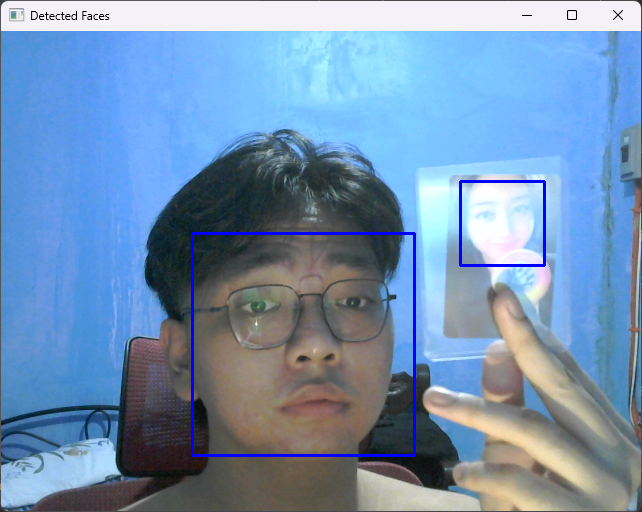

### Task 2: Face Recognition

In [22]:
import numpy as np
import os
import errno
import sys
import cv2

def read_images(path, sz=None):
    c = 0
    X, y = [], []

    for dirname, dirnames, filenames in os.walk(path):
        for subdirname in dirnames:
            subject_path = os.path.join(dirname, subdirname)
            for filename in os.listdir(subject_path):
                try:
                    if filename == ".directory":
                        continue
                    filepath = os.path.join(subject_path, filename)
                    im = cv2.imread(filepath, cv2.IMREAD_GRAYSCALE)

                    # Resize the images to the prescribed size if sz is provided
                    if sz is not None:
                        im = cv2.resize(im, sz)

                    X.append(np.asarray(im, dtype=np.uint8))
                    y.append(c)

                except IOError as e:
                    print(f"I/O Error({e.errno}): {e.strerror}")
                except Exception as e:
                    print("Unexpected error:", e)

            c += 1

    return [X, y]

def face_rec():
    names = ['Berja', 'Enzo', 'Unknown', 'Viray', 'Dave']  # Put your names here for faces to recognize

    # Provide the path to your image dataset folder here
    dataset_path = 'C:/Users/Itanaki/Documents/Emtech/Dataset'

    # Call the function to read images from the dataset directory
    X, y = read_images(dataset_path)
    y = np.asarray(y, dtype=np.int32)

    # Create a face recognition modelq
    model = cv2.face.EigenFaceRecognizer_create()
    #model = cv2.face.FisherFaceRecognizer_create()
    #model = cv2.face.LBPHFaceRecognizer_create()
    model.train(X, y)

    camera = cv2.VideoCapture(0)
    face_cascade = cv2.CascadeClassifier('C://Users//Itanaki//Documents//Emtech//haarcascade_frontalface_default.xml')

    while True:
        ret, img = camera.read()
        if not ret:
            break

        faces = face_cascade.detectMultiScale(img, 1.3, 5)

        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
            gray = cv2.cvtColor(img[y:y + h, x:x + w], cv2.COLOR_BGR2GRAY)
            roi = cv2.resize(gray, (200, 200), interpolation=cv2.INTER_LINEAR)

            try:
                params = model.predict(roi)
                label = names[params[0]]
                cv2.putText(img, label + ", " + str(params[1]), (x, y - 20), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)
            except:
                cv2.putText(img, label + "Unknown" + str(params[1]), (x, y - 20), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)

        cv2.imshow("camera", img)
        if cv2.waitKey(1) & 0xFF == ord("q"):
            break
    camera.release()
    cv2.destroyAllWindows()

if __name__ == "__main__":
  face_rec()

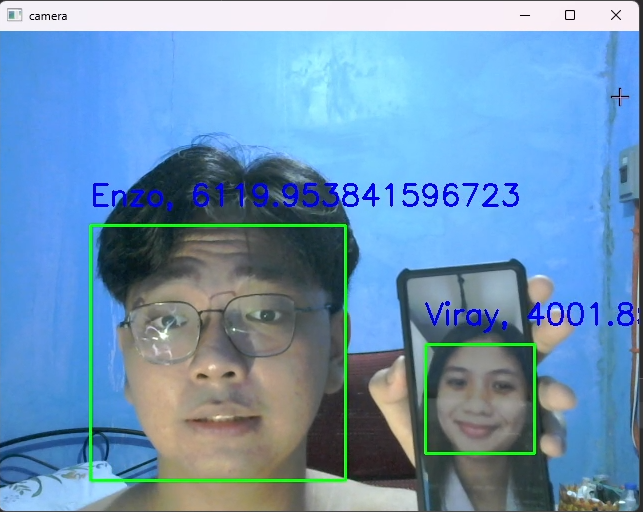

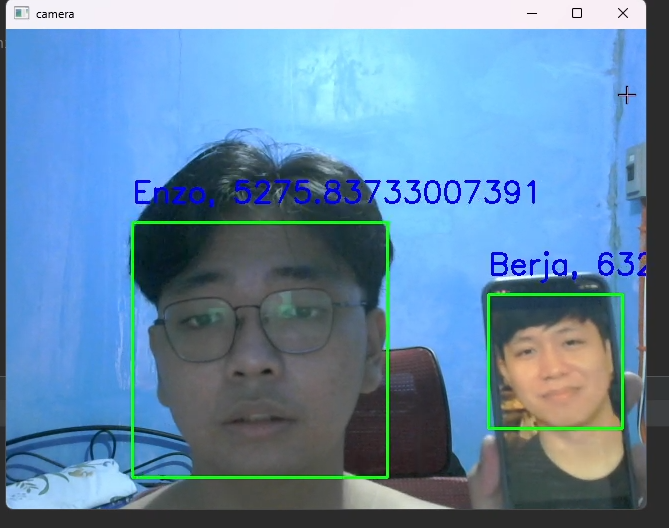

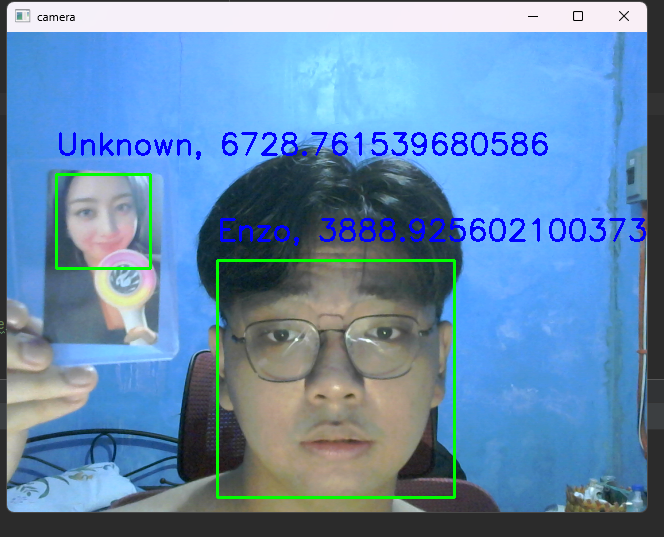

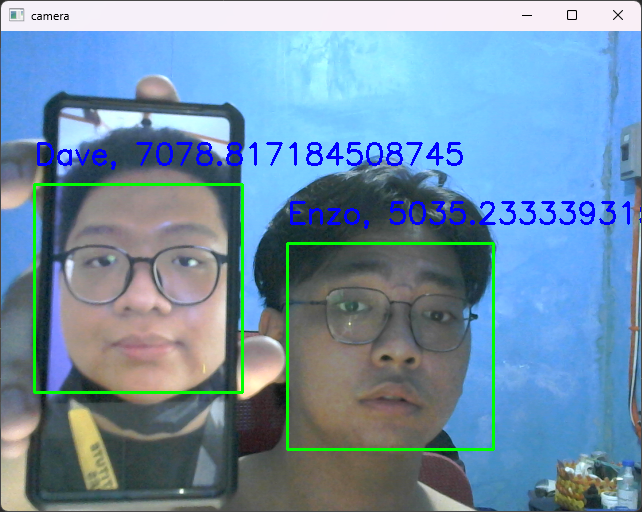

### Task 3: Mood Detection

In [23]:
# Technique 1

import cv2
import numpy as np
from keras.models import model_from_json


emotion_dict = {0: "Angry", 1: "Disgusted", 2: "Fearful", 3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"}

# load json and create model
json_file = open('model/emotion_model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
emotion_model = model_from_json(loaded_model_json)

# load weights into new model
emotion_model.load_weights("model/emotion_model.h5")
print("Loaded model from disk")

# start the webcam feed
cap = cv2.VideoCapture(0)


while True:
    # Find haar cascade to draw bounding box around face
    ret, frame = cap.read()
    frame = cv2.resize(frame, (1280, 720))
    if not ret:
        break
    face_detector = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_default.xml')
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # detect faces available on camera
    num_faces = face_detector.detectMultiScale(gray_frame, scaleFactor=1.3, minNeighbors=5)

    # take each face available on the camera and Preprocess it
    for (x, y, w, h) in num_faces:
        cv2.rectangle(frame, (x, y-50), (x+w, y+h+10), (0, 255, 0), 4)
        roi_gray_frame = gray_frame[y:y + h, x:x + w]
        cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray_frame, (48, 48)), -1), 0)

        # predict the emotions
        emotion_prediction = emotion_model.predict(cropped_img)
        maxindex = int(np.argmax(emotion_prediction))
        cv2.putText(frame, emotion_dict[maxindex], (x+5, y-20), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_AA)

    cv2.imshow('Emotion Detection', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


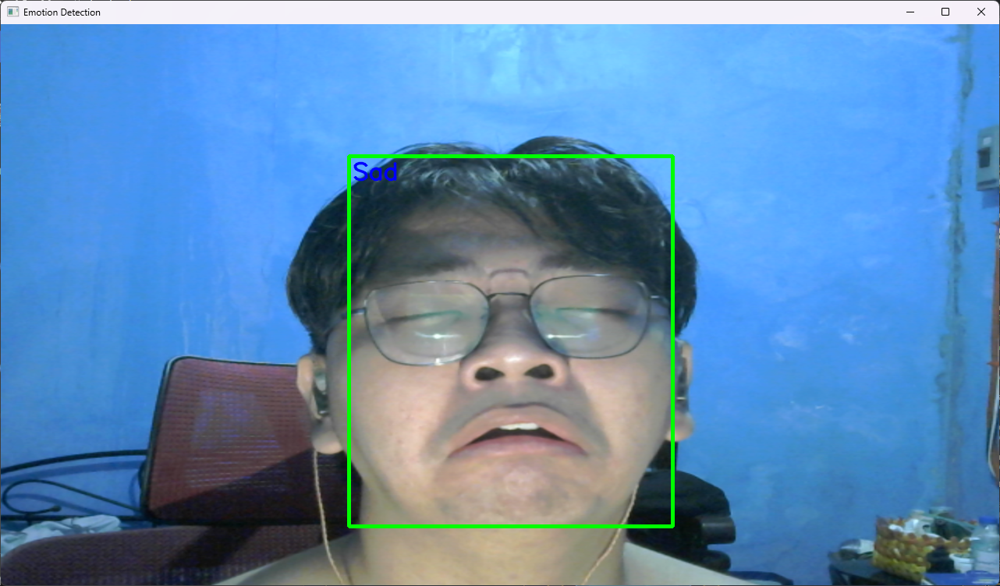

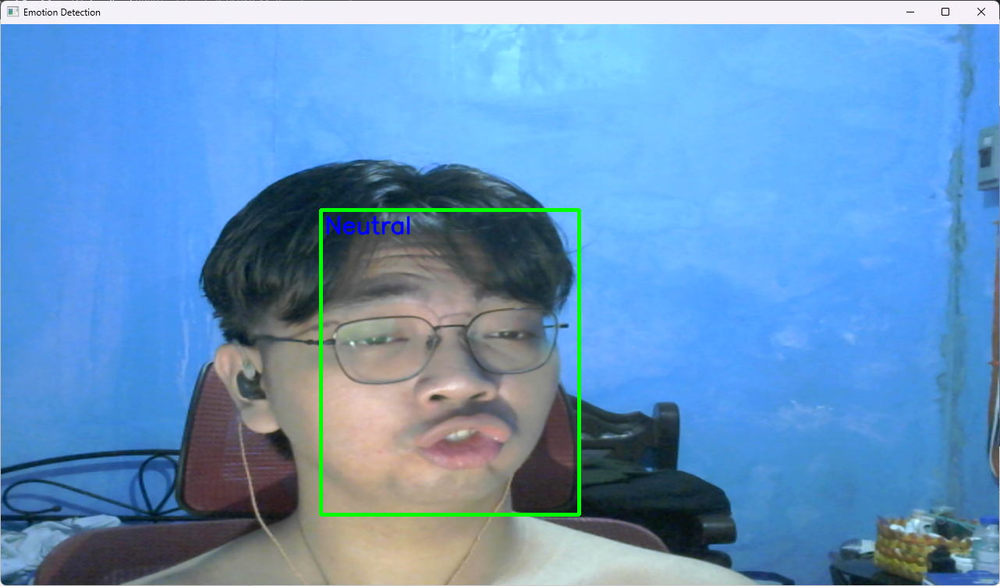

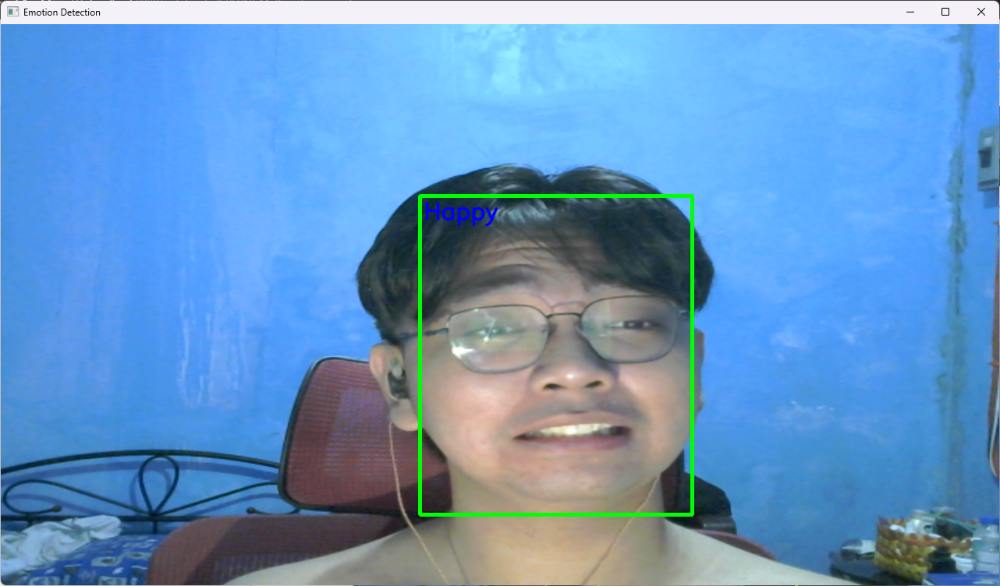

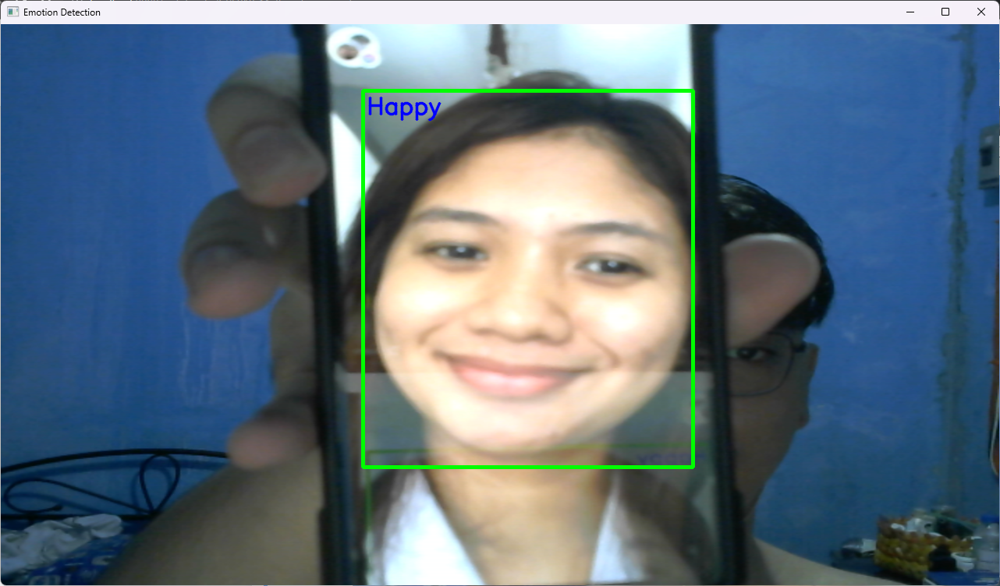

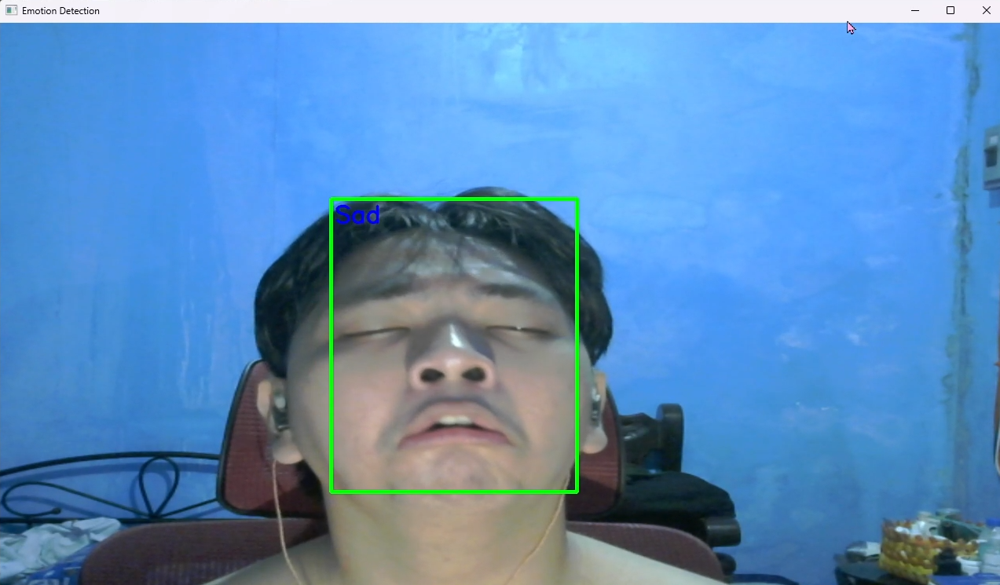

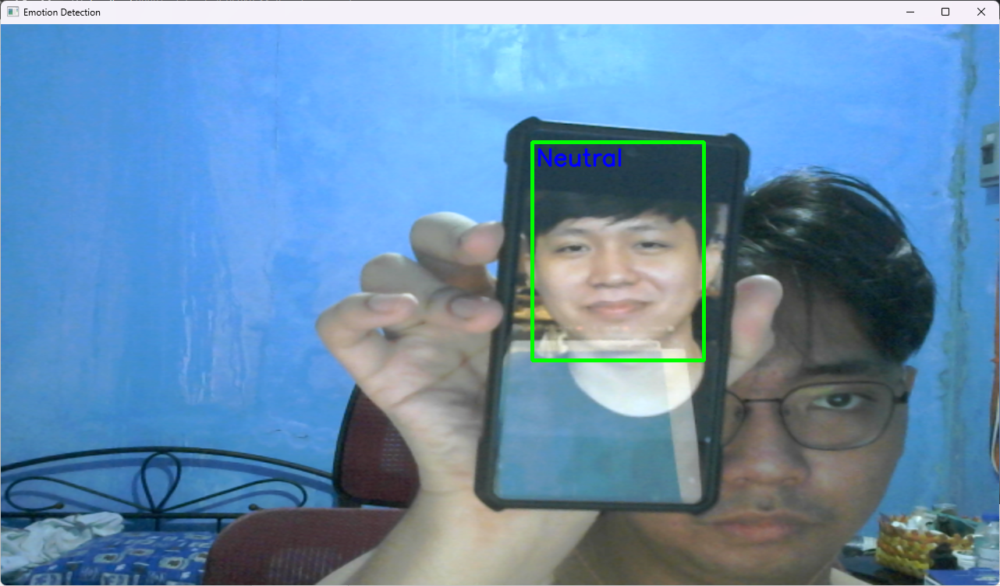

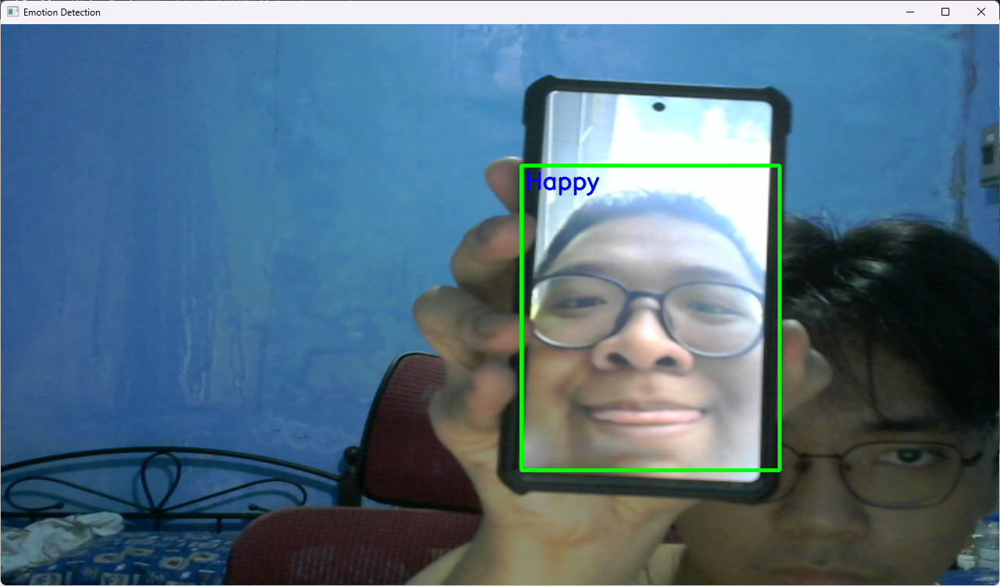

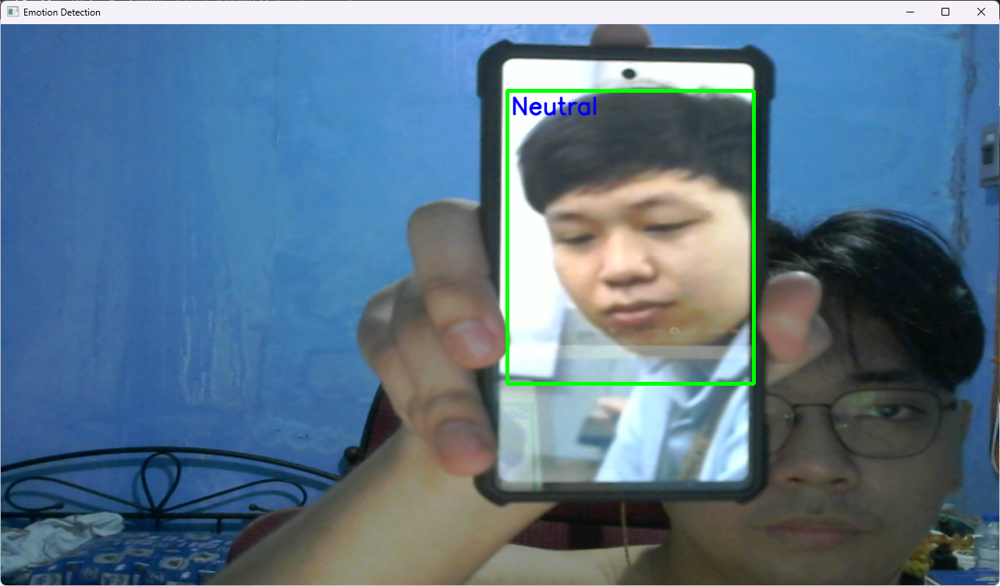

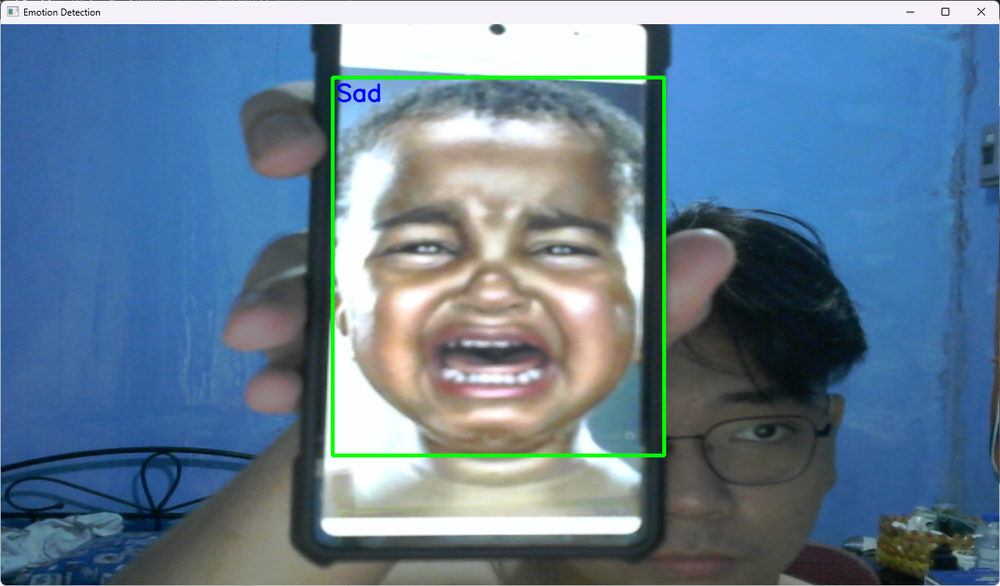

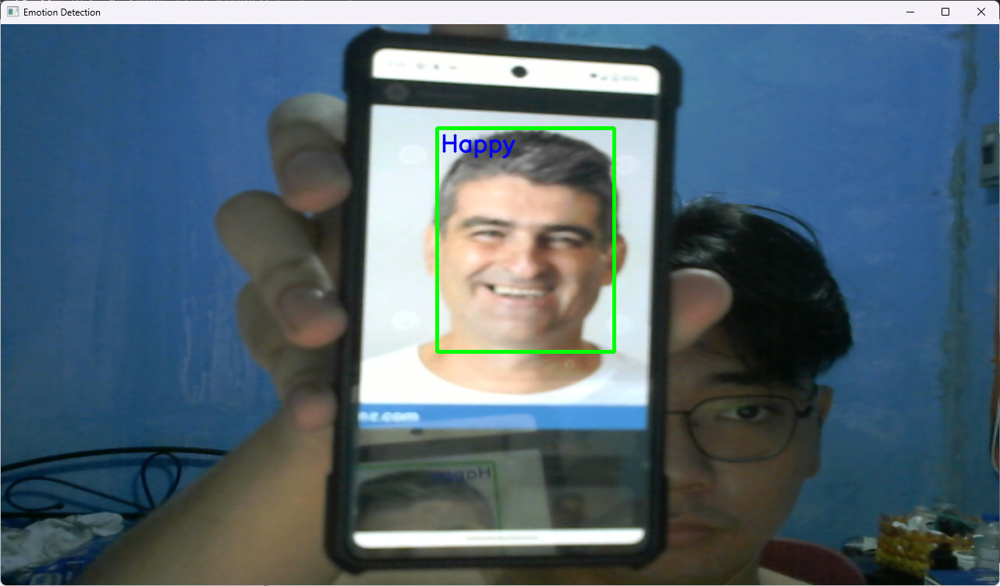

In [9]:
# Import the module for tabulating the data
from tabulate import tabulate
 
# Create a list for content of the table
test_results = [
    ["1", "Sad", "Sad", 1],
    ["2", "Neutral", "Neutral", 1],
    ["3", "Happy", "Happy", 1],
    ["4", "Happy", "Happy", 1],
    ["5", "Sad", "Sad", 1],
    ["6", "Happy", "Neutral", 0],
    ["7", "Happy", "Happy", 1],
    ["8", "Neutral", "Neutral", 1],
    ["9", "Sad", "Sad", 1],
    ["10", "Happy", "Happy", 1]
]
 
# Create a list for the headers of your table
header = ["Test #", "Expected", "Actual", "Score"]
 
# display table
print("Task 3A: Mood Detection using XYZ Algorithm")
print(tabulate(test_results, headers=header, tablefmt="grid"))

# Calculate for the accuracy
total = 0
for i in test_results:
    total += i[3]
print("Accuracy: ", round(total/len(test_results)*100,2))

Task 3A: Mood Detection using XYZ Algorithm
+----------+------------+----------+---------+
|   Test # | Expected   | Actual   |   Score |
+==========+============+==========+=========+
|        1 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        2 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        3 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        4 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        5 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        6 | Happy      | Neutral  |       0 |
+----------+------------+----------+---------+
|        7 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        8 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        9 | Sad        | Sad      |       1 |
+----------+----

Technique 1 is the most accurate among the 3 techniques, because it uses data that has model faces over a hundred model faces each face which gives more accuracy in it's detection, it uses an imported library of models and uses haarcascade also. 

In [10]:
# Technique 2
import cv2
from deepface import DeepFace

# Initialize the face classifier
face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

cap = cv2.VideoCapture(0)

while True:
    ret, frame = cap.read()
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Detect faces
    faces = face_classifier.detectMultiScale(frame_gray, scaleFactor=1.3, minNeighbors=5)

    # Loop over detected faces
    for face in faces:
        x, y, w, h = face
        roi = frame[y:y + h, x:x + w]

        try:
            # Attempt to analyze the face using DeepFace
            response = DeepFace.analyze(roi, actions=["emotion"], enforce_detection=False)
            print(response)  # Print the response to understand its structure

            emotion = response['emotion']

            # Draw rectangle around the face
            cv2.rectangle(frame, (x, y), (x + w, y + h), color=(255, 0, 0), thickness=2)

            # Display the emotion
            cv2.putText(frame, f'Emotion: {emotion}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 0, 255), 2)
        except Exception as e:
            print(f"Error analyzing face: {e}")

    # Display the frame
    cv2.imshow("", frame)

    # Break the loop if 'q' key is pressed
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

# Release the camera and close all windows
cap.release()
cv2.destroyAllWindows()


ModuleNotFoundError: No module named 'keras'

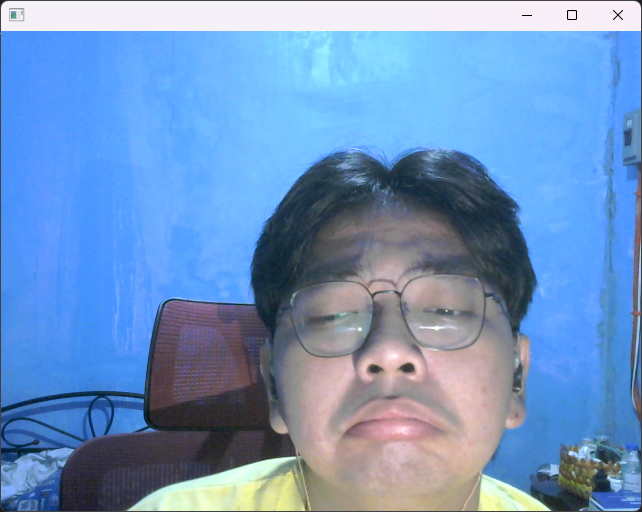

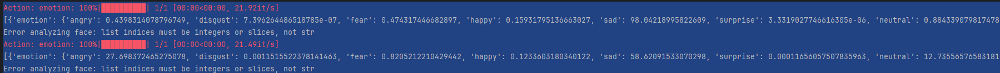

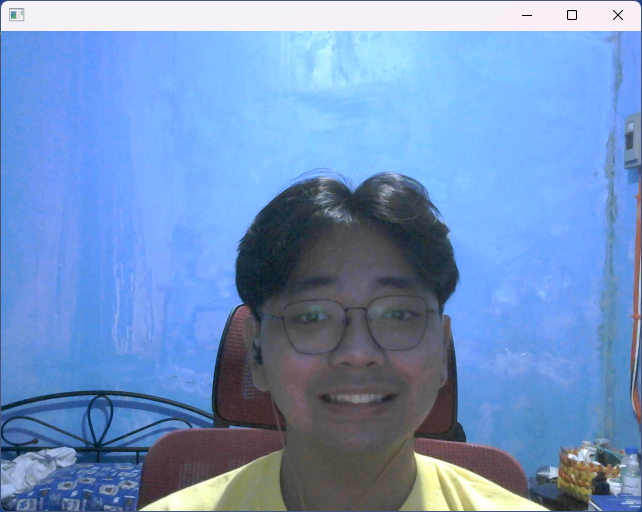

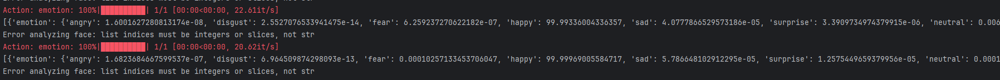

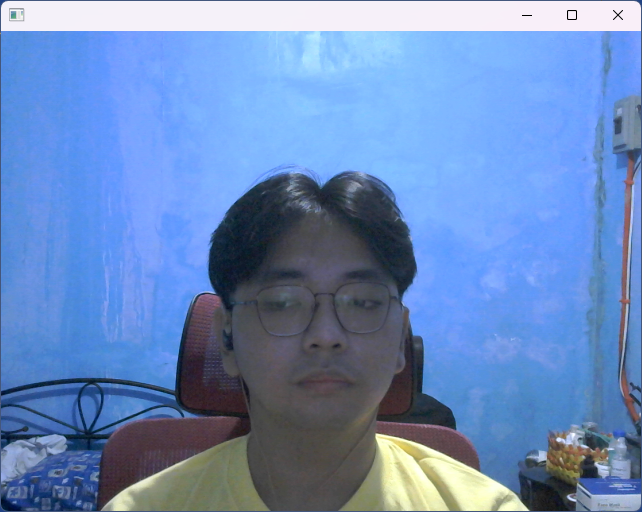

...

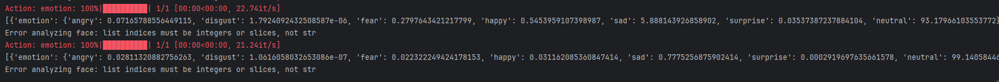

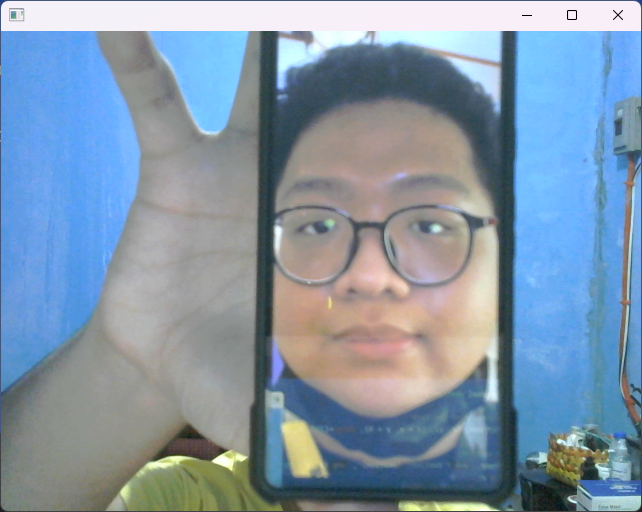

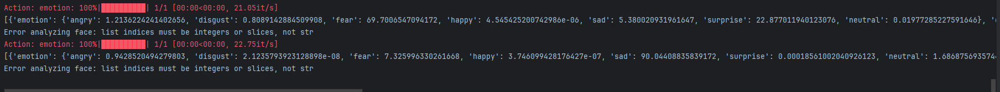

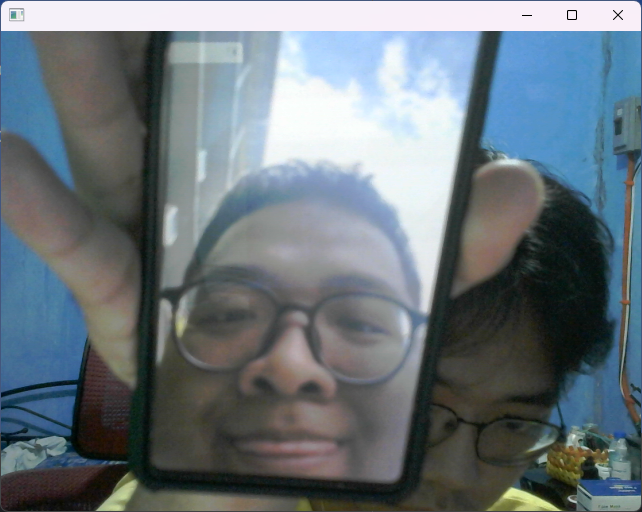

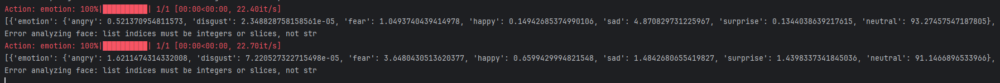

In [14]:
# Import the module for tabulating the data
from tabulate import tabulate
 
# Create a list for content of the table
test_results = [
    ["1", "Sad", "Sad", 1],
    ["2", "Neutral", "Neutral", 1],
    ["3", "Happy", "Happy", 1],
    ["4", "Happy", "Happy", 1],
    ["5", "Sad", "Sad", 1],
    ["6", "Sad", "Neutral", 0],
    ["7", "Happy", "Happy", 1],
    ["8", "Neutral", "Neutral", 1],
    ["9", "Neutral", "Sad", 0],
    ["10", "Happy", "Neutral", 0]
]
 
# Create a list for the headers of your table
header = ["Test #", "Expected", "Actual", "Score"]
 
# display table
print("Task 3A: Mood Detection using XYZ Algorithm")
print(tabulate(test_results, headers=header, tablefmt="grid"))

# Calculate for the accuracy
total = 0
for i in test_results:
    total += i[3]
print("Accuracy: ", round(total/len(test_results)*100,2))

Task 3A: Mood Detection using XYZ Algorithm
+----------+------------+----------+---------+
|   Test # | Expected   | Actual   |   Score |
+==========+============+==========+=========+
|        1 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        2 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        3 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        4 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        5 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        6 | Sad        | Neutral  |       0 |
+----------+------------+----------+---------+
|        7 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        8 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        9 | Neutral    | Sad      |       0 |
+----------+----

Technique 2's performance is subpar with technique 1 because it gives all the percentage of emotions detected then summarizes it which is the most dominant emotion present. In this case it uses the deep face library and haarcades, which also gives model of emotions to base its detection. 

In [ ]:
# Technique 3
import cv2
import numpy as np

def detect_mood(corners):
    happy_threshold = 300
    sad_threshold = 100

    corner_count = len(corners[0])

    if corner_count > happy_threshold:
        return 'Happy'
    elif corner_count < sad_threshold:
        return 'Sad '
    else:
        return 'Neutral'

# Load the pre-trained face cascade
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

cap = cv2.VideoCapture(0)

while True:
    ret, frame = cap.read()

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Detect faces in the frame with adjusted parameters
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    for (x, y, w, h) in faces:
        # Apply Harris corner detection within the face region
        roi_gray = gray[y:y+h, x:x+w]

        corners = cv2.cornerHarris(roi_gray, 2, 3, 0.04)
        corners = cv2.dilate(corners, None)

        # Mark corners on the frame
        frame[y:y+h, x:x+w][corners > 0.01 * corners.max()] = [0, 0, 255]

        mood = detect_mood(np.where(corners > 0.01 * corners.max()))

        cv2.putText(frame, f'Mood: {mood}', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

    cv2.imshow('Mood Detection', frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


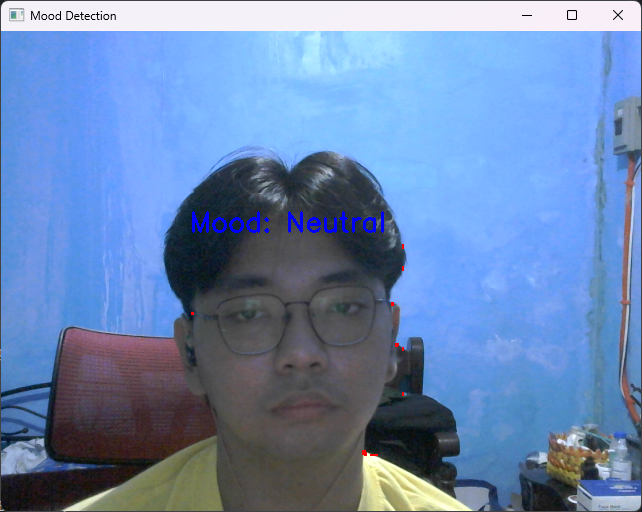

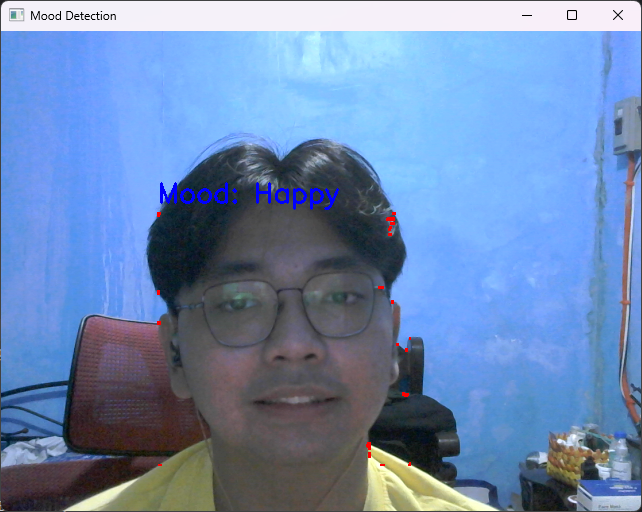

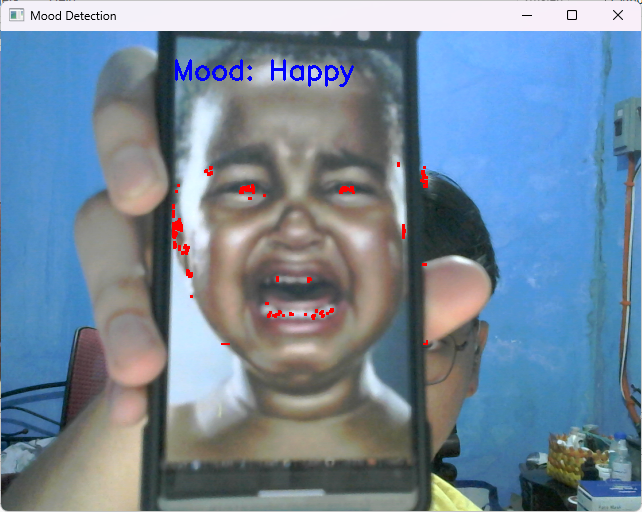

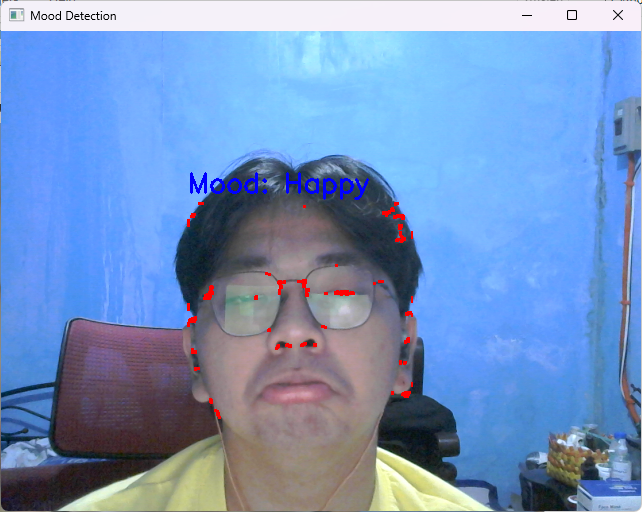

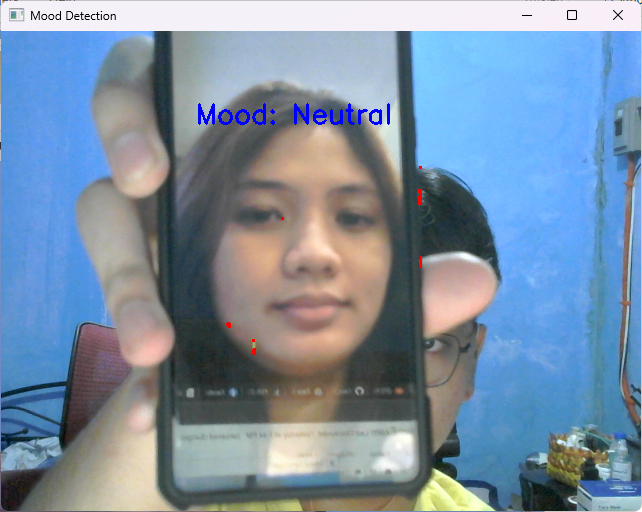

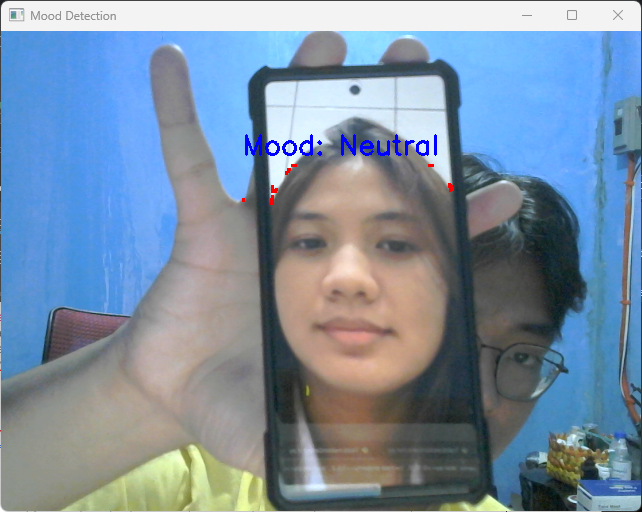

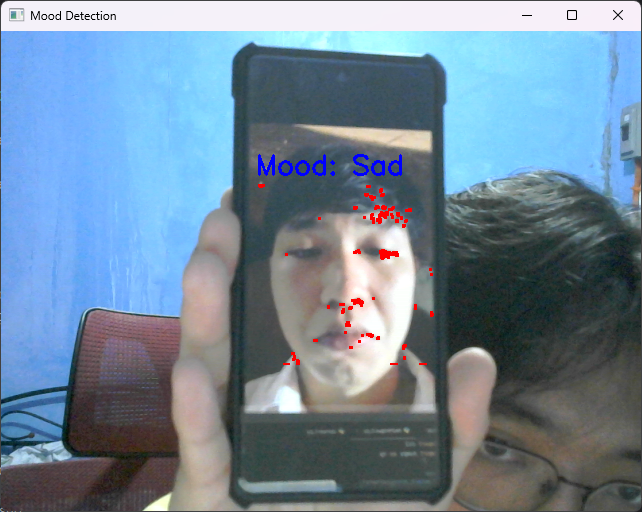

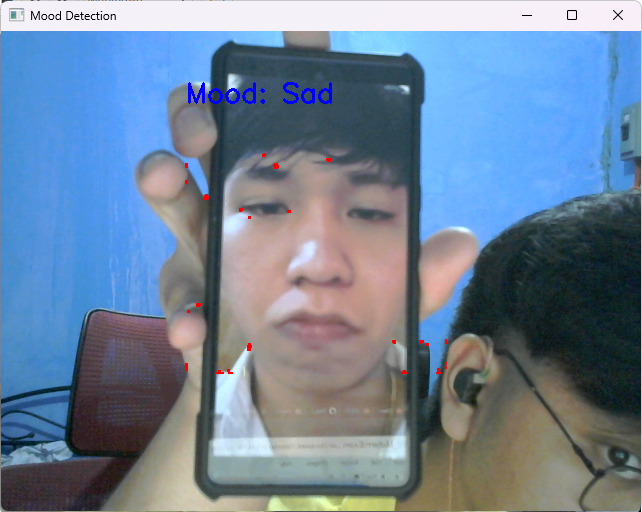

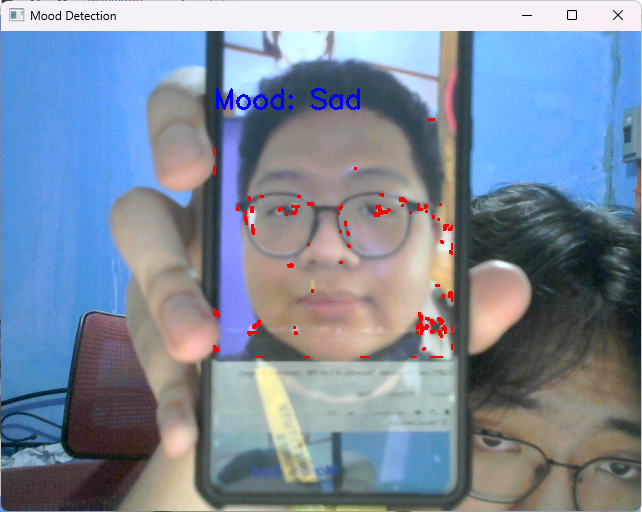

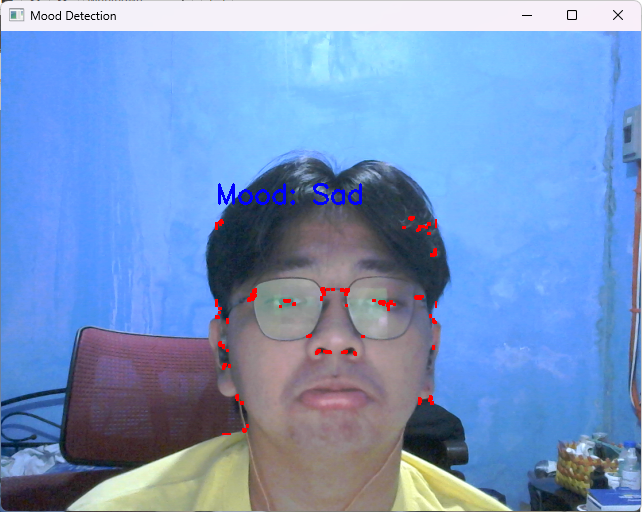

---

In [13]:
# Import the module for tabulating the data
from tabulate import tabulate
 
# Create a list for content of the table
test_results = [
    ["1", "Neutral", "Neutral", 1],
    ["2", "Happy", "Happy", 1],
    ["3", "Sad", "Happy", 0],
    ["4", "Sad", "Happy", 0],
    ["5", "Neutral", "Neutral", 1],
    ["6", "Neutral", "Neutral", 1],
    ["7", "Sad", "Sad", 1],
    ["8", "Sad", "Sad", 1],
    ["9", "Neutral", "Sad", 0],
    ["10", "Sad", "Sad", 1]
]
 
# Create a list for the headers of your table
header = ["Test #", "Expected", "Actual", "Score"]
 
# display table
print("Task 3A: Mood Detection using XYZ Algorithm")
print(tabulate(test_results, headers=header, tablefmt="grid"))

# Calculate for the accuracy
total = 0
for i in test_results:
    total += i[3]
print("Accuracy: ", round(total/len(test_results)*100,2))

Task 3A: Mood Detection using XYZ Algorithm
+----------+------------+----------+---------+
|   Test # | Expected   | Actual   |   Score |
+==========+============+==========+=========+
|        1 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        2 | Happy      | Happy    |       1 |
+----------+------------+----------+---------+
|        3 | Sad        | Happy    |       0 |
+----------+------------+----------+---------+
|        4 | Sad        | Happy    |       0 |
+----------+------------+----------+---------+
|        5 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        6 | Neutral    | Neutral  |       1 |
+----------+------------+----------+---------+
|        7 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        8 | Sad        | Sad      |       1 |
+----------+------------+----------+---------+
|        9 | Neutral    | Sad      |       0 |
+----------+----

As notices in technique 3 it is the most innaccurate among the 3 techniques used, you need to be in a certain angle to be detected as the correct emotion, this is happening because it base it's detector in the corners detected on the face. Which is why it is unreliable. 

## Analysis

For the three different techniques you used in face detection, provide an in-depth analysis. 

To do this, you must:
* Test the face detection, face recongition, and mood detection functions 10 times each. Only the mood detection will have components for 10 tests for each different technique used.
* Create a table containing the 10 tests (like shown below) for each task.
* Analyze each output by identifying the accuracy and providing your observations.

## Summary and Lessons Learned

Viray:
Delving into this activity provided us an immersive journey into the complexities of object-oriented programming and feature detection, with a specific focus on mood detection. The diverse tasks which are spanning from the subtleties of face and emotion dectection, required a profound understanding of algorithmic nuances. The tasks was to encompass 10 tests for each mood detection technique, which was an application of learned methods from the previous activities.This repeated exploration not only highlighted the practical side of using these methods but also showed the critical importance of being flexible at making algorithms work well. What I've learned from this experience not only added to my practical skills but also made me value the step-by-step approach in handling tough real-world problems even more.

Zapanta:
Through this Midterm Exam, I was able to honed my skills in object-oriented programming and feature detection, specifically in mood detection. The tasks, ranging from face detection to recognition and mood analysis, emphasized the importance of meticulous testing and evaluation for algorithm optimization.The thorough testing and evaluation, extended to 10 tests for each mood detection technique, emerged as a crucial aspect of the iterative process. It showcased the practical application of learned techniques but also underscored the need for adaptability and continuous refinement in addressing real-world challenges. 

Berja:
The tasks in this exam served as an immersive exploration of object-oriented programming and feature detection, that culminates the development of a mood detection program. From detecting faces to recognizing them and analyzing moods, it was important to understand each step clearly. The tasks includes conducting 10 tests for each mood detection technique which revealed nuances in algorithmic behavior, reinforcing the significance of adaptability and continual refinement for achieving accurate and effective solutions. This experience not only solidified my grasp of practical application but also instilled the value of meticulous testing in optimizing algorithms for real-world scenarios.

Padual:
This activity was a comprehensive exploration of feature matching and detection that centers mood detection through object-oriented programming. From the intricacies of face detection to the nuanced task of recognizing emotions, each step demanded a thorough understanding of the algorithm. The iterative process of conducting 10 tests for each mood detection revealed the practical applications of methods from previous activities but also emphasized the importance of adaptability and continual refinement. This experience deepened my understanding of algorithmic development, highlighting the iterative approach as a cornerstone for addressing complex real-world problems and optimizing solutions for accuracy and effectiveness.

**Proprietary Clause**

Property of the Technological Institute of the Philippines (T.I.P.). No part of the materials made and uploaded in this learning management system by T.I.P. may be copied, photographed, printed, reproduced, shared, transmitted, translated or reduced to any electronic medium or machine-readable form, in whole or in part, without prior consent of T.I.P.

Prepared by Engr. RMR